In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [3]:
import numpy as np
import torch
import scanpy as sc
import muon as mu
import anndata
import mudata
import pandas as pd

print(anndata.__version__)
print(mudata.__version__)
print(sc.__version__)
print(torch.__version__)


0.8.0
0.2.1
1.9.2
1.11.0


In [4]:
sc.set_figure_params(scanpy=True, fontsize=14, figsize=[5, 5])

In [5]:
%load_ext autoreload
%autoreload 2

In [6]:
from src.types import TrainParams
from src.model import ModelParams
from src.smvae.model import SMVAE
from src.smvae.train import train_smvae
from src.smvae.dataloader import *
from src.smvae.diagnostics import plot_embedding, classification_performance

from src.mvae.model import MVAE
from src.mvae.train import train_mvae
from src.mvae.dataloader import setup_mudata
from src.mvae.diagnostics import plot_embedding, classification_performance

In [7]:
# mdata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_preprocessed_final_filtered.h5mu')
# metadata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_metadata.h5mu')
# mdata.obs["new_ann"] = metadata.obs["new_ann"]
# mdata.mod["msi"].obs["new_ann"] = metadata.obs["new_ann"]
# mdata.mod["rna"].obs["new_ann"] = metadata.obs["new_ann"]
# mdata
mdata = mu.read('/media/gambino/students_workdir/anna/OtF-prostate/data/mdata_out_smvae.h5mu')

In [13]:
mdata.obs["tissue_name"] = mdata.obs["tissue"].apply(lambda x: "Cancer" if x == "DLC2" else "Normal")
mdata.obs["cell_type"] = mdata.obs["new_ann"]

In [15]:
def sample_transl(x):
    patient = x.split("_")[0]
    status = x.split("_")[1]
    if status == "DLC2":
        return f"{patient}_cancer"
    return f"{patient}_normal"
mdata.obs["sample_name"] = mdata.obs["sample"].apply(lambda x: sample_transl(x))
mdata.obs["sample_name"]

304-929_cancer_20um     PWB929_cancer
1304-929_cancer_20um    PWB929_cancer
1522-929_cancer_20um    PWB929_cancer
163-929_cancer_20um     PWB929_cancer
347-929_cancer_20um     PWB929_cancer
                            ...      
2671-952_normal_10um    PWB952_normal
1517-952_normal_10um    PWB952_normal
57-952_normal_10um      PWB952_normal
2176-952_normal_10um    PWB952_normal
2224-952_normal_10um    PWB952_normal
Name: sample_name, Length: 42475, dtype: category
Categories (16, object): ['PWB929_normal', 'PWB929_cancer', 'PWB931_normal', 'PWB931_cancer', ..., 'PWB950_normal', 'PWB950_cancer', 'PWB952_normal', 'PWB952_cancer']

### Save output of all SMVAE models

In [128]:
models = {
    "smvae_beta0.5": "smvae_prostate_nolisi_beta0.5_20230513-172539.pt",
    "smvae_beta0.1": "smvae_prostate_nolisi_beta0.1_20230513-002431.pt",
    "smvae_beta0.01": "smvae_prostate_nolisi_fullshared_20230429-174252.pt",
    "smvae_beta0.001": "smvae_prostate_nolisi_beta0.001_20230512-195310.pt",
    "smvae_beta0.1_gamma0.0001": "smvae_prostate_lisi_poe_beta0.1_gamma0.0001_20230513-014606.pt",
    "smvae_beta0.001_gamma0.0001": "smvae_prostate_lisi_poe_beta0.001_gamma0.0001_20230502-031102.pt",
    "smvae_beta0.001_gamma0.0003": "smvae_prostate_lisi_poe_beta0.001_gamma0.0003_20230503-151506.pt",
    "smvae_beta0.001_gamma0.0005": "smvae_prostate_lisi_poe_beta0.001_gamma0.0005_20230502-133449.pt",
    "smvae_beta0.001_gamma0.001": "smvae_prostate_lisi_poe_beta0.001_gamma0.001_20230502-001455.pt",
    "smvae_beta0.001_gamma0.01": "smvae_prostate_lisi_poe_beta0.001_20230430-012112.pt",
    "smvae_beta0.001_gamma0.0001_delta0.1": "smvae_prostate_lisi_private_beta0.001_gamma0.0001_delta0.1_20230502-170820.pt",
    "smvae_beta0.001_gamma0.0005_delta0.1": "smvae_prostate_lisi_private_beta0.001_gamma0.0005_delta0.1_20230503-015025.pt"
}

train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128)
model_params = ModelParams(beta=0.001, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)

In [153]:
torch.set_num_threads(16)

for m, file in {"smvae_beta0.1_gamma0.0001": "smvae_prostate_lisi_poe_beta0.1_gamma0.0001_20230513-014606.pt"}.items():
    print(m)
    model = SMVAE(mdata, model_params)
    model.load_state_dict(torch.load(f"vae_params/{file}"))
    from src.smvae.train import to_latent
    poe, rna_p, msi_p, rna_s, msi_s = to_latent(model, mdata, "sample", train_params)
    mdata.obsm[f"{m}_z1_s"] = np.vstack(rna_s)
    mdata.obsm[f"{m}_z2_s"] = np.vstack(msi_s)
    mdata.obsm[f"{m}_z1_p"] = np.vstack(rna_p)
    mdata.obsm[f"{m}_z2_p"] = np.vstack(msi_p)
    mdata.obsm[f"{m}_z"] = np.vstack([x.numpy() for x in poe])
    
    for layer in ["z1_s", "z2_s", "z1_p", "z2_p"]:
        sc.pp.neighbors(
            mdata, n_neighbors=5, use_rep=f"{m}_{layer}", key_added=f"{m}_neigh_{layer}"
        )
        sc.tl.umap(mdata, neighbors_key=f"{m}_neigh_{layer}")
        mdata.obsm[f"X_{m}_{layer}"] = mdata.obsm["X_umap"]
    
    sc.pp.neighbors(mdata, use_rep=f"{m}_z", n_neighbors=30)
    sc.tl.umap(mdata)
    mdata.obsm[f"X_{m}_z"] = mdata.obsm["X_umap"]


smvae_beta0.1_gamma0.0001
(42475, 18950)
(42475, 12510)


100%|█████████████████████████████████████████| 332/332 [00:33<00:00,  9.91it/s]


In [154]:
mdata.write('/media/gambino/students_workdir/anna/OtF-prostate/data/mdata_out_smvae.h5mu')

smvae_beta0.001


/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


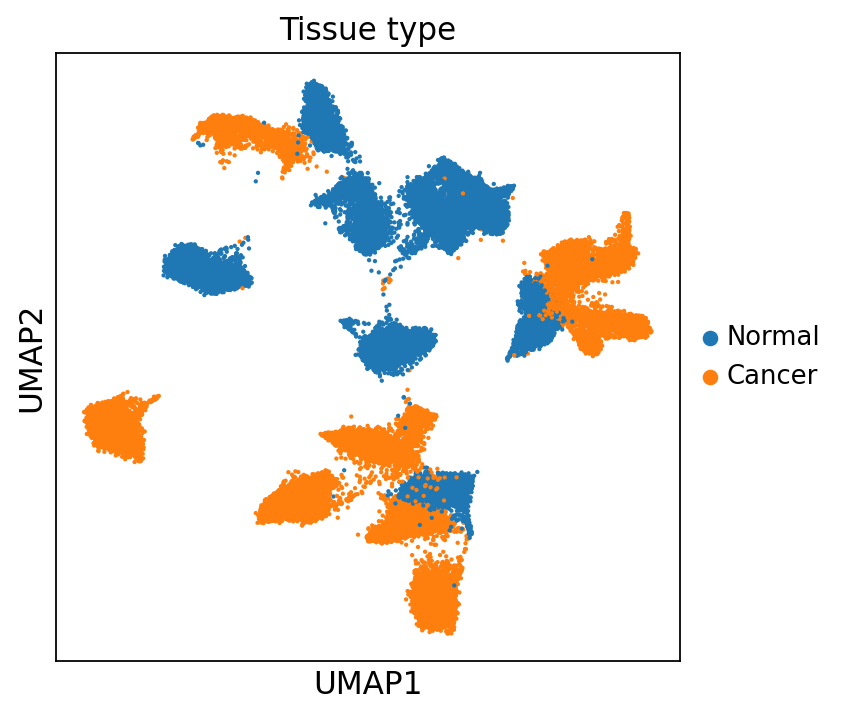

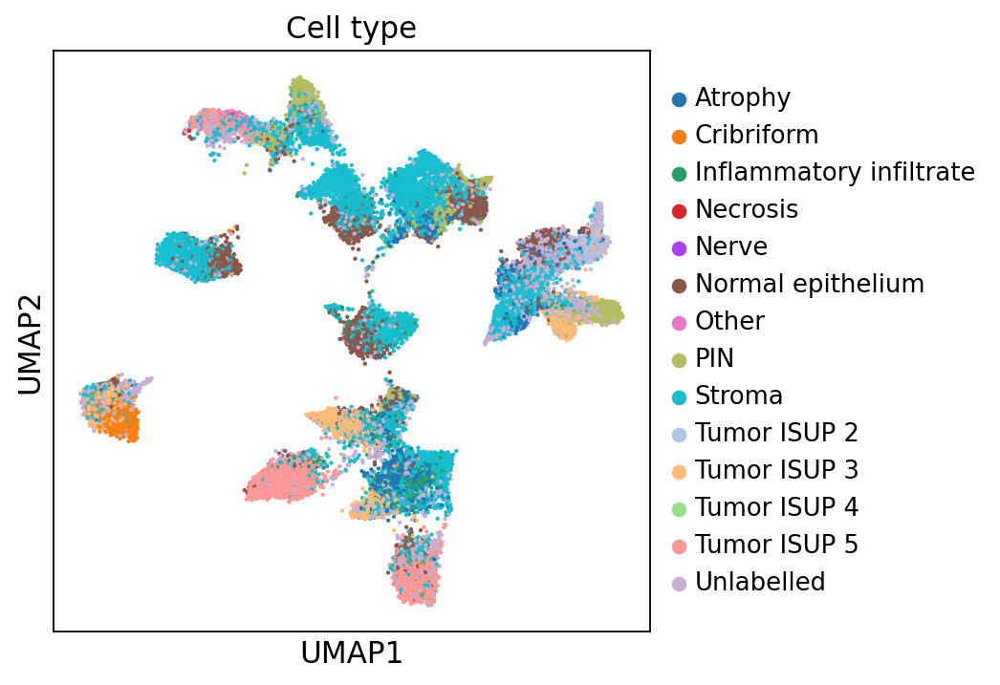

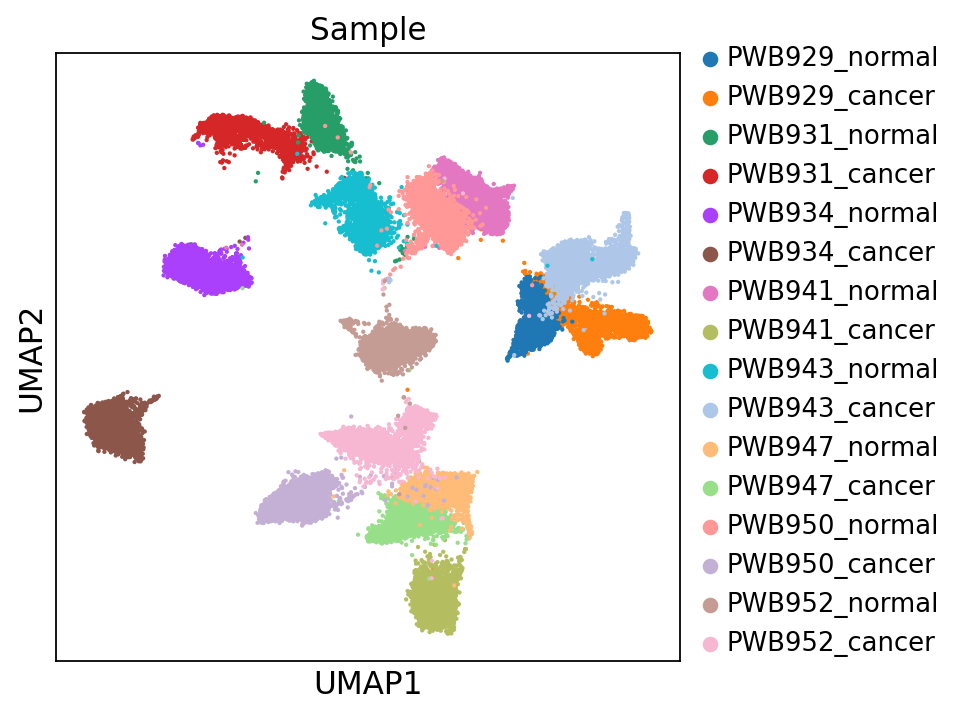

In [213]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

m = "smvae_beta0.001"
print(m)

# ["#3976AF", "#F08536", "#4F9B6C", "#C53A32", "#9D50F3", "#84584E", "#D57FBE", "#B6BC6D", "#56BBCC", "#B3C7E5", "#F6BD82", "#A8DC93", "#F19D99", "#C2B2D2"]
ax = sc.pl.embedding(mdata, f"X_{m}_z", color="tissue_name", show=False, title="Tissue type", legend_fontsize="small", size=15)
ax.set_xlabel("UMAP1")
ax.set_ylabel("UMAP2")


ax2 = sc.pl.embedding(mdata, f"X_{m}_z", color="cell_type", show=False, title="Cell type", legend_fontsize="small", size=15)
ax2.set_xlabel("UMAP1")
ax2.set_ylabel("UMAP2")

ax3 = sc.pl.embedding(mdata, f"X_{m}_z", color="sample_name", show=False, title="Sample", legend_fontsize="x-small", size=15) 
ax3.set_xlabel("UMAP1")
ax3.set_ylabel("UMAP2")
ax3.legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 1.05), frameon=False)

## RNA private change

smvae_beta0.001 smvae_beta0.001_gamma0.0001 smvae_beta0.001_gamma0.001


/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'Sample'}, xlabel='X_smvae_beta0.001_gamma0.01_z2_p1', ylabel='X_smvae_beta0.001_gamma0.01_z2_p2'>

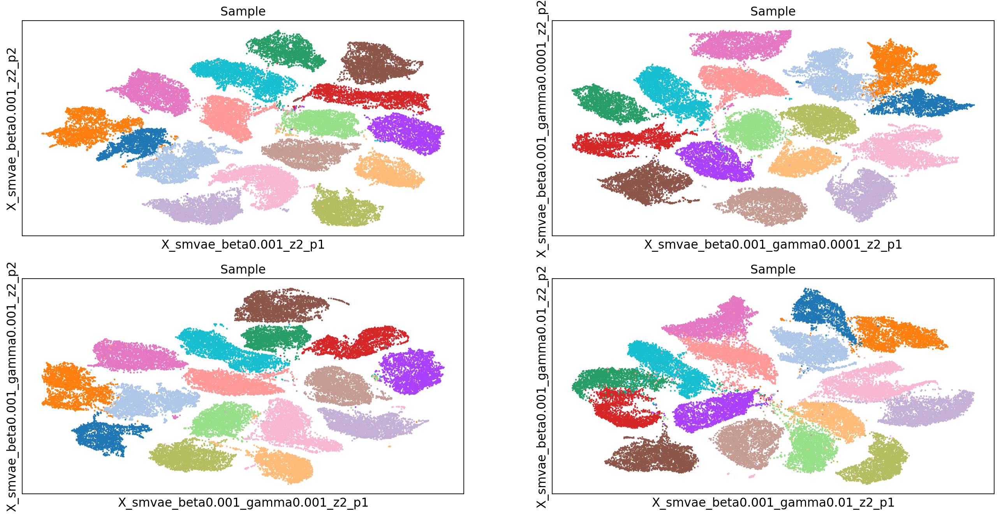

In [159]:
m1 = "smvae_beta0.001"
m2 = "smvae_beta0.001_gamma0.0001"
m3 = "smvae_beta0.001_gamma0.001"
m4 = "smvae_beta0.001_gamma0.01"
print(m1, m2, m3)

fig, axes = plt.subplots(2, 2, figsize=[20, 10])

sc.pl.embedding(mdata, f"X_{m1}_z1_p", ax=axes[0][0], color="sample_name", show=False, title="Sample", legend_loc=None, size=15)

sc.pl.embedding(mdata, f"X_{m2}_z1_p", ax=axes[0][1], color="sample_name", show=False, title="Sample", legend_loc=None, size=15)

sc.pl.embedding(mdata,  f"X_{m3}_z1_p",ax=axes[1][0], color="sample_name", show=False, title="Sample", legend_loc=None, size=15)

sc.pl.embedding(mdata,  f"X_{m4}_z1_p",ax=axes[1][1], color="sample_name", show=False, title="Sample", legend_loc=None, size=15) 

## Shared change with beta

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/

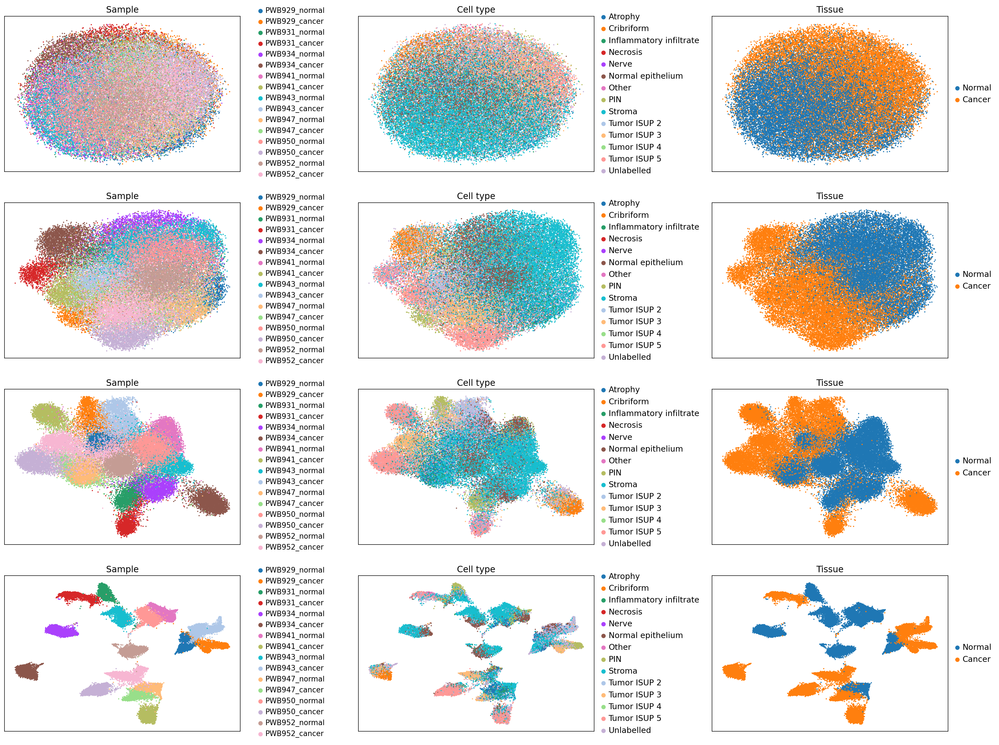

In [135]:
fig, axes = plt.subplots(4, 3, figsize=[27, 21])
fig.subplots_adjust(wspace=0.5)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
    sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="Cell type", size=15)
    sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
    axes[i][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1.05, 1.1), frameon=False)
for ax_arr in axes:
    for ax in ax_arr:
        ax.set_ylabel("")
        ax.set_xlabel("")
# plt.savefig("test.png", bbox_inches="tight", pad_inches=0.5)

### Private change with beta

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/

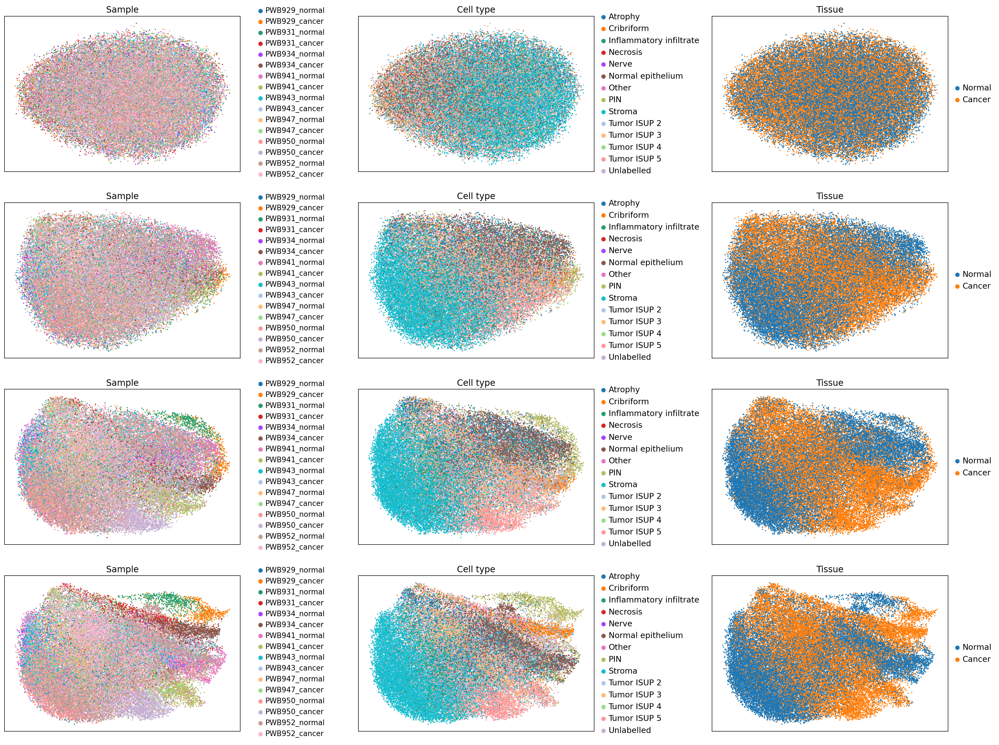

In [144]:
fig, axes = plt.subplots(4, 3, figsize=[27, 21])
fig.subplots_adjust(wspace=0.5)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
    sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="Cell type", size=15)
    sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
    axes[i][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1.05, 1.1), frameon=False)
for ax_arr in axes:
    for ax in ax_arr:
        ax.set_ylabel("")
        ax.set_xlabel("")
# plt.savefig("test.png", bbox_inches="tight", pad_inches=0.5)

### Shared change with gamma

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/

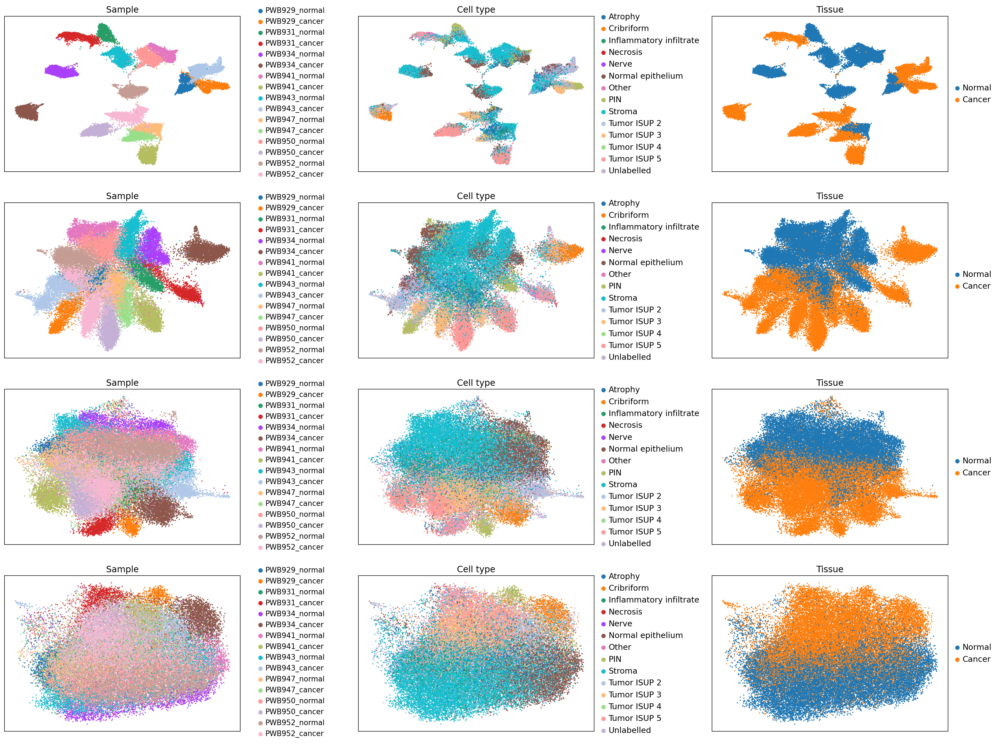

In [158]:
fig, axes = plt.subplots(4, 3, figsize=[27, 21])
fig.subplots_adjust(wspace=0.5)
for i, m in enumerate(["smvae_beta0.001", "smvae_beta0.001_gamma0.0001", "smvae_beta0.001_gamma0.0003", "smvae_beta0.001_gamma0.0005"]):
    sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
    sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="Cell type", size=15)
    sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
    axes[i][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1.05, 1.1), frameon=False)
for ax_arr in axes:
    for ax in ax_arr:
        ax.set_ylabel("")
        ax.set_xlabel("")
# plt.savefig("test.png", bbox_inches="tight", pad_inches=0.5)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


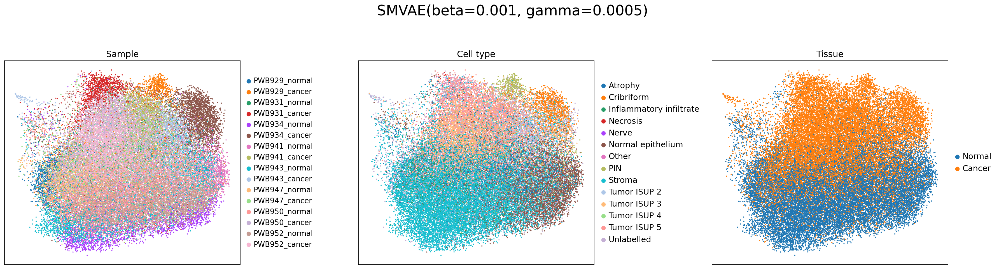

In [266]:
m1 = "smvae_beta0.001_gamma0.0005"

fig, axes = plt.subplots(1, 3, sharex=True, figsize=[27, 7])
fig.subplots_adjust(wspace=0.5, top=0.8)
fig.suptitle("SMVAE(beta=0.001, gamma=0.0005)", fontsize=23, x=0.6)
sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[0], color="sample_name", show=False, title="Sample", size=15)

sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[1], color="cell_type", show=False, title="Cell type", size=15)

sc.pl.embedding(mdata,  f"X_{m1}_z",ax=axes[2], color="tissue_name", show=False, title="Tissue", size=15)
axes[0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 0.95), frameon=False)
for ax in axes:
    ax.set_ylabel("")
    ax.set_xlabel("")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


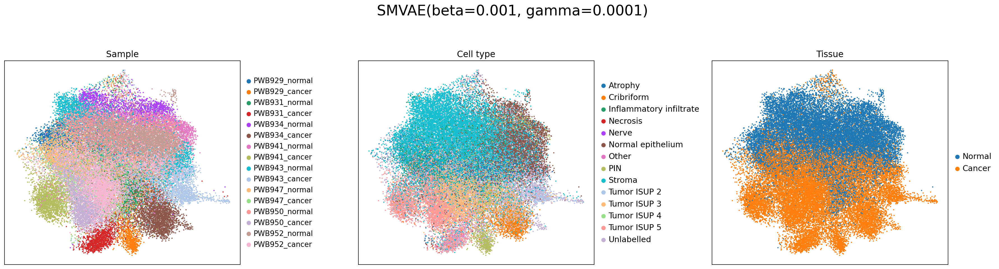

In [262]:
m1 = "smvae_beta0.001_gamma0.0003"

fig, axes = plt.subplots(1, 3, sharex=True, figsize=[27, 7])
fig.subplots_adjust(wspace=0.5, top=0.8)
fig.suptitle("SMVAE(beta=0.001, gamma=0.0001)", fontsize=23, x=0.6)
sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[0], color="sample_name", show=False, title="Sample", size=15)

sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[1], color="cell_type", show=False, title="Cell type", size=15)

sc.pl.embedding(mdata,  f"X_{m1}_z",ax=axes[2], color="tissue_name", show=False, title="Tissue", size=15)
axes[0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 0.95), frameon=False)
for ax in axes:
    ax.set_ylabel("")
    ax.set_xlabel("")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


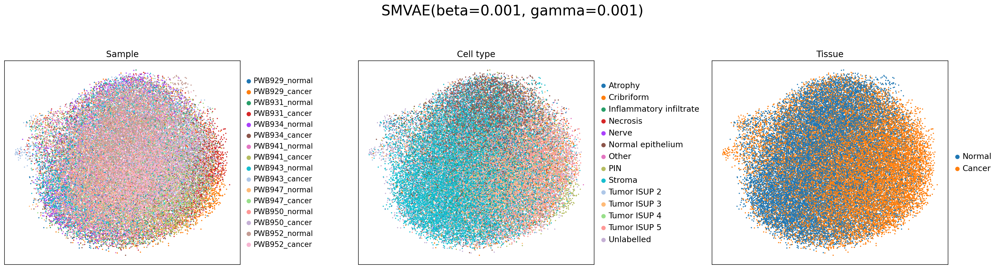

In [267]:
m1 = "smvae_beta0.001_gamma0.001"

fig, axes = plt.subplots(1, 3, sharex=True, figsize=[27, 7])
fig.subplots_adjust(wspace=0.5, top=0.8)
fig.suptitle("SMVAE(beta=0.001, gamma=0.001)", fontsize=23, x=0.6)
sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[0], color="sample_name", show=False, title="Sample", size=15)

sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[1], color="cell_type", show=False, title="Cell type", size=15)

sc.pl.embedding(mdata,  f"X_{m1}_z",ax=axes[2], color="tissue_name", show=False, title="Tissue", size=15)
axes[0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 0.95), frameon=False)
for ax in axes:
    ax.set_ylabel("")
    ax.set_xlabel("")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


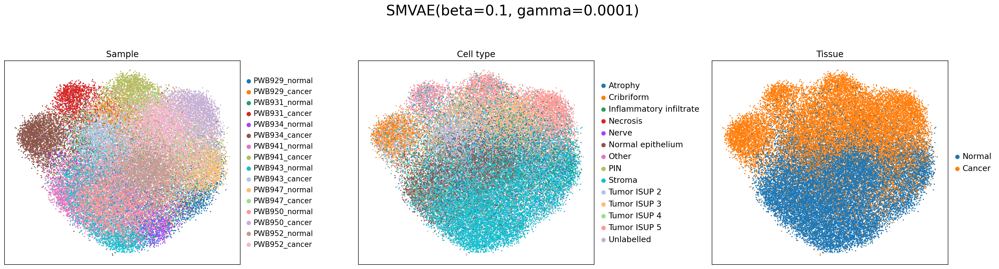

In [353]:
m1 = "smvae_beta0.1_gamma0.0001"

fig, axes = plt.subplots(1, 3, sharex=True, figsize=[27, 7])
fig.subplots_adjust(wspace=0.5, top=0.8)
fig.suptitle("SMVAE(beta=0.1, gamma=0.0001)", fontsize=23, x=0.6)
sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[0], color="sample_name", show=False, title="Sample", size=15)

sc.pl.embedding(mdata, f"X_{m1}_z", ax=axes[1], color="cell_type", show=False, title="Cell type", size=15)

sc.pl.embedding(mdata,  f"X_{m1}_z",ax=axes[2], color="tissue_name", show=False, title="Tissue", size=15)
axes[0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 0.95), frameon=False)
for ax in axes:
    ax.set_ylabel("")
    ax.set_xlabel("")

In [7]:
rna = mdata.mod["rna"]
sc.pp.neighbors(rna, n_neighbors=30)
sc.tl.umap(rna)

         Falling back to preprocessing with `sc.pp.pca` and default params.


/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


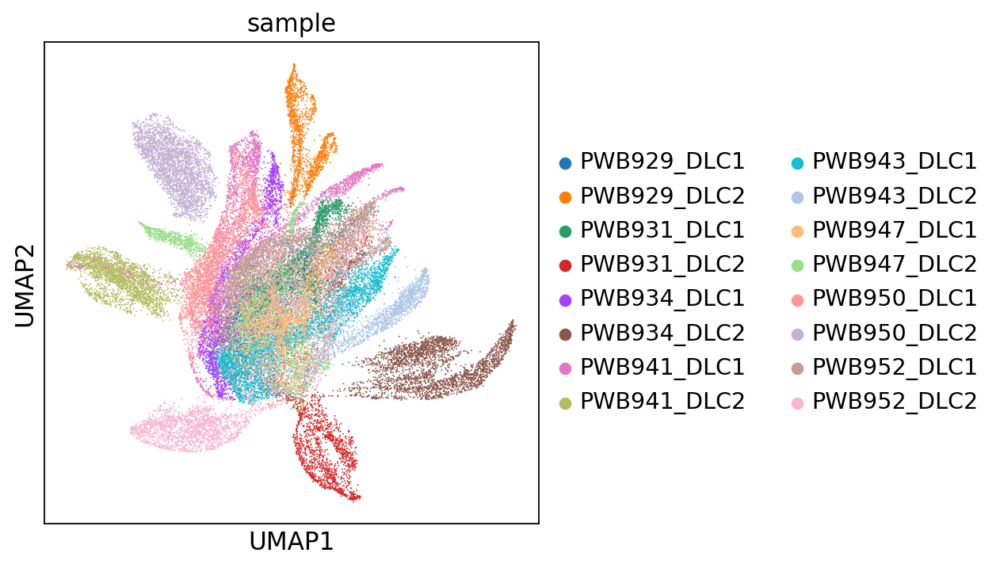

In [27]:
sc.pl.umap(rna, color=["sample"])

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


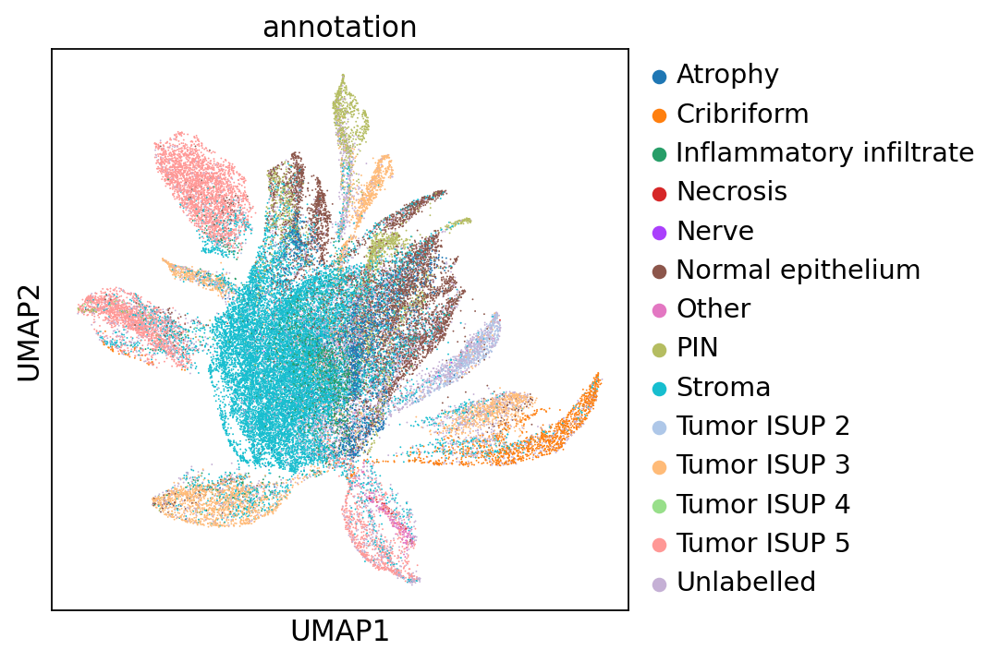

In [28]:
sc.pl.umap(rna, color=["new_ann"], title="annotation")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


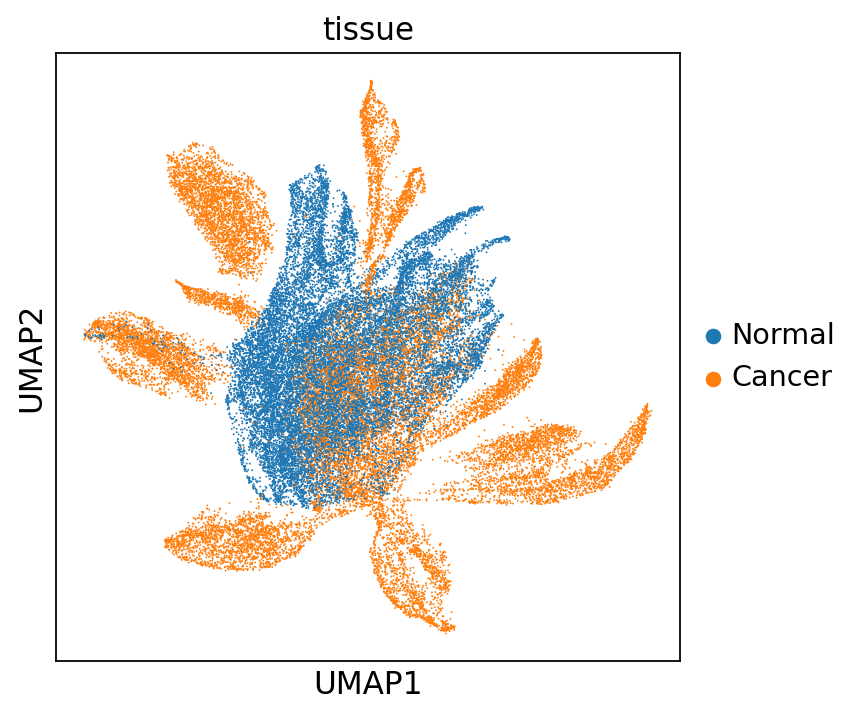

In [29]:
sc.pl.umap(rna, color=["tissue_name"], title="tissue")

In [30]:
msi = mdata.mod["msi"]
sc.pp.neighbors(msi, n_neighbors=30)
sc.tl.umap(msi)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [31]:
msi.obs["tissue_name"] = mdata.obs["tissue_name"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


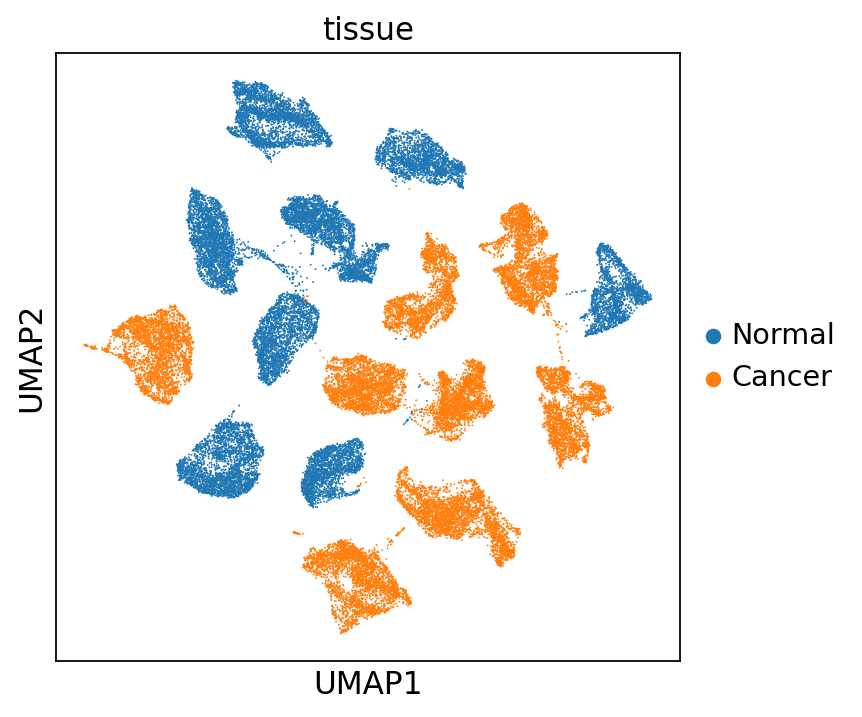

In [36]:
sc.pl.umap(msi, color=["tissue_name"], title="tissue")

## Logs

In [10]:
from src.utils import get_loss_logs, make_plot

In [124]:
model = models["smvae_beta0.1"]
runlog_data_gamma0 = get_loss_logs(model)
model = models["smvae_beta0.1_gamma0.0001"]
runlog_data = get_loss_logs(model)

In [126]:
runlog_data_gamma0["model"] = "SMVAE(beta=0.1, gamma=0)"
runlog_data["model"] = "SMVAE(beta=0.1, gamma=0.0001)"

rd1 = runlog_data_gamma0.loc[:,["step","PoE_training/total_loss", 
                                "PoE_training/kl", "PoE_training/kl_rna_p", "PoE_training/kl_rna_s", 
                                "PoE_training/kl_msi_p", "PoE_training/kl_msi_s", "model"]]
rd2 = runlog_data.loc[:, ["step", "PoE_training/total_loss", 
                                "PoE_training/kl", "PoE_training/kl_rna_p", "PoE_training/kl_rna_s", 
                                "PoE_training/kl_msi_p", "PoE_training/kl_msi_s", "model"]]
data = pd.concat([rd1,rd2], ignore_index=True)
data["model"] = data["model"].astype("category")
data = data[data["step"] < 6000]

<Axes: ylabel='PoE_training/batch_integration'>

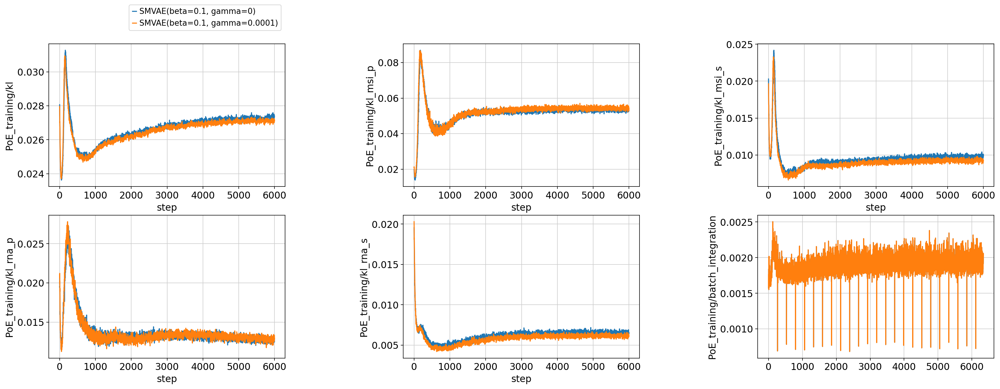

In [127]:
import matplotlib.pyplot as plt
import seaborn as sns
fig, axes = plt.subplots(2, 3, figsize=(25, 10))
fig.subplots_adjust(wspace=0.5, top=0.8)

sns.lineplot(ax=axes[0][0], data=data, x="step", y="PoE_training/kl", hue="model")
axes[0][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 1.3))
sns.lineplot(ax=axes[0][1], data=data, x="step", y="PoE_training/kl_msi_p", hue="model", legend=False)
sns.lineplot(ax=axes[0][2], data=data, x="step", y="PoE_training/kl_msi_s", hue="model", legend=False)
sns.lineplot(ax=axes[1][0], data=data, x="step", y="PoE_training/kl_rna_p", hue="model", legend=False)
sns.lineplot(ax=axes[1][1], data=data, x="step", y="PoE_training/kl_rna_s", hue="model", legend=False)
sns.lineplot(ax=axes[1][2], data=runlog_data["PoE_training/batch_integration"])
sns.lineplot(ax=axes[1][2], data=runlog_data["PoE_training/batch_integration"])

In [109]:
model = models["smvae_beta0.001"]
runlog_data_gamma0 = get_loss_logs(model)

model = models["smvae_beta0.001_gamma0.0001"]
runlog_data = get_loss_logs(model)

runlog_data_gamma0["model"] = "SMVAE(beta=0.001, gamma=0)"
runlog_data["model"] = "SMVAE(beta=0.001, gamma=0.0001)"

rd1 = runlog_data_gamma0.loc[:,["step","PoE_training/total_loss", 
                                "PoE_training/kl", "PoE_training/kl_rna_p", "PoE_training/kl_rna_s", 
                                "PoE_training/kl_msi_p", "PoE_training/kl_msi_s", "model"]]
rd2 = runlog_data.loc[:, ["step", "PoE_training/total_loss", 
                                "PoE_training/kl", "PoE_training/kl_rna_p", "PoE_training/kl_rna_s", 
                                "PoE_training/kl_msi_p", "PoE_training/kl_msi_s", "model"]]
data = pd.concat([rd1,rd2], ignore_index=True)
data["model"] = data["model"].astype("category")
# data = data[data["step"] < 6000]
data

,step,PoE_training/total_loss,PoE_training/kl,PoE_training/kl_rna_p,PoE_training/kl_rna_s,PoE_training/kl_msi_p,PoE_training/kl_msi_s,model
0,0,14.478992,0.000276,0.000209,0.000204,0.000198,0.000223,"SMVAE(beta=0.001, gamma=0)"
1,1,14.30624,0.000278,0.000216,0.000211,0.000195,0.000223,"SMVAE(beta=0.001, gamma=0)"
2,2,14.323019,0.00028,0.000222,0.000215,0.000201,0.000225,"SMVAE(beta=0.001, gamma=0)"
3,3,14.142189,0.000279,0.000229,0.000214,0.000201,0.000226,"SMVAE(beta=0.001, gamma=0)"
4,4,14.031739,0.000281,0.000228,0.000221,0.000203,0.000224,"SMVAE(beta=0.001, gamma=0)"
...,...,...,...,...,...,...,...,...
23137,11167,1.700258,0.00064,0.000488,0.000294,0.001834,0.000447,"SMVAE(beta=0.001, gamma=0.0001)"
23138,11168,1.679779,0.000637,0.000498,0.000289,0.001843,0.000447,"SMVAE(beta=0.001, gamma=0.0001)"
23139,11169,1.709638,0.000637,0.000485,0.000287,0.001875,0.000446,"SMVAE(beta=0.001, gamma=0.0001)"
23140,11170,1.715488,0.000637,0.000496,0.000287,0.001855,0.000447,"SMVAE(beta=0.001, gamma=0.0001)"


<Axes: ylabel='PoE_training/batch_integration'>

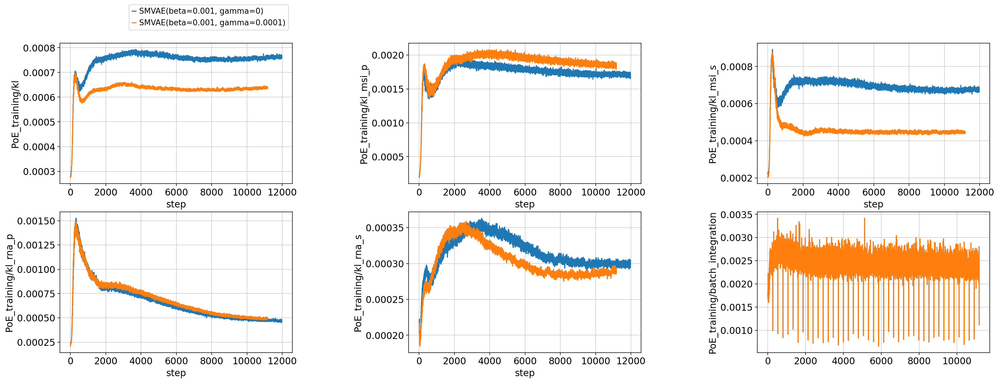

In [122]:
import matplotlib.pyplot as plt
import seaborn as sns
fig, axes = plt.subplots(2, 3, figsize=(25, 10))
fig.subplots_adjust(wspace=0.5, top=0.8)

sns.lineplot(ax=axes[0][0], data=data, x="step", y="PoE_training/kl", hue="model")
axes[0][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 1.3))
sns.lineplot(ax=axes[0][1], data=data, x="step", y="PoE_training/kl_msi_p", hue="model", legend=False)
sns.lineplot(ax=axes[0][2], data=data, x="step", y="PoE_training/kl_msi_s", hue="model", legend=False)
sns.lineplot(ax=axes[1][0], data=data, x="step", y="PoE_training/kl_rna_p", hue="model", legend=False)
sns.lineplot(ax=axes[1][1], data=data, x="step", y="PoE_training/kl_rna_s", hue="model", legend=False)
sns.lineplot(ax=axes[1][2], data=runlog_data["PoE_training/batch_integration"])
sns.lineplot(ax=axes[1][2], data=runlog_data["PoE_training/batch_integration"])

## Classification

In [139]:
from src.smvae.diagnostics import classification_performance
from tqdm import tqdm

perf_df = pd.read_csv("classification/smvae")
# perf_df = pd.DataFrame(index=mdata.obs["sample"].unique(), columns=models.keys())

# for m in models.keys():
#     for sample in tqdm(mdata.obs["sample"].unique()):
#         perf_df.loc[sample, m] = classification_performance(mdata, label_key="new_ann", embed_key=f"X_{m}_z", loo=sample)[0]
#     perf_df.to_csv("classification/smvae")

In [162]:
m = "smvae_beta0.1_gamma0.0001"
for sample in tqdm(mdata.obs["sample"].unique()):
    perf_df.loc[sample, m] = classification_performance(mdata, label_key="new_ann", embed_key=f"X_{m}_z", loo=sample)[0]

100%|███████████████████████████████████████████| 16/16 [01:20<00:00,  5.01s/it]


In [160]:
models.keys()

dict_keys(['smvae_beta0.5', 'smvae_beta0.1', 'smvae_beta0.01', 'smvae_beta0.001', 'smvae_beta0.1_gamma0.0001', 'smvae_beta0.001_gamma0.0001', 'smvae_beta0.001_gamma0.0003', 'smvae_beta0.001_gamma0.0005', 'smvae_beta0.001_gamma0.001', 'smvae_beta0.001_gamma0.01', 'smvae_beta0.001_gamma0.0001_delta0.1', 'smvae_beta0.001_gamma0.0005_delta0.1'])

In [163]:
perf_df.mean()

/tmp/ipykernel_276968/3976431540.py:1: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  perf_df.mean()


smvae_beta0.01                          0.304465
smvae_beta0.001                         0.310817
smvae_beta0.001_gamma0.0001             0.330750
smvae_beta0.001_gamma0.0003             0.372189
smvae_beta0.001_gamma0.0005             0.360455
smvae_beta0.001_gamma0.001              0.306326
smvae_beta0.001_gamma0.01               0.319260
smvae_beta0.001_gamma0.0001_delta0.1    0.345189
smvae_beta0.001_gamma0.0005_delta0.1    0.338460
smvae_beta0.1                           0.328104
smvae_beta0.1_gamma0.0001               0.324787
smvae_beta0.5                           0.288841
dtype: float64

In [175]:
mdata.mod["rna"].obs

,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mt,log1p_total_counts_mt,...,size_factors,sample,type,patient,ann,tissue,imagerow,imagecol,new_ann,batch_id
304-929_cancer_20um,1,8,70,4534,8.419580,17412.719454,9.765014,19.179123,839.446730,6.733934,...,1.179337,PWB929_DLC2,cancer,PWB929,Tumor ISUP 3,DLC2,44.222397,66.889674,Tumor ISUP 3,0
1304-929_cancer_20um,1,36,82,2592,7.860571,3884.117414,8.264908,10.714600,4.131048,1.635310,...,0.684553,PWB929_DLC2,cancer,PWB929,Tumor ISUP 3,DLC2,123.847786,90.858705,Unlabelled,0
1522-929_cancer_20um,1,43,85,3982,8.289791,10666.085011,9.274918,14.548663,250.478965,5.527359,...,1.072024,PWB929_DLC2,cancer,PWB929,Tumor ISUP 3,DLC2,143.733759,96.810055,Unlabelled,0
163-929_cancer_20um,1,4,70,3010,8.010028,7222.426338,8.885085,17.957739,37.598282,3.653208,...,0.785027,PWB929_DLC2,cancer,PWB929,Tumor ISUP 4,DLC2,32.607061,66.077223,Tumor ISUP 3,0
347-929_cancer_20um,1,10,42,5448,8.603187,26307.992590,10.177666,18.456749,746.524365,6.616767,...,1.340003,PWB929_DLC2,cancer,PWB929,Tumor ISUP 3,DLC2,52.640503,18.068652,Tumor ISUP 3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2671-952_normal_10um,1,72,38,2460,7.808323,6922.884613,8.842732,16.298503,457.770080,6.128549,...,0.733556,PWB952_DLC1,normal,PWB952,Benign,DLC1,78.532882,133.446450,Stroma,15
1517-952_normal_10um,1,45,91,3104,8.040769,9430.403001,9.151800,13.445732,126.395586,4.847297,...,0.954928,PWB952_DLC1,normal,PWB952,Benign,DLC1,154.624230,38.799268,Stroma,15
57-952_normal_10um,1,8,64,3763,8.233238,11187.271927,9.322621,13.345898,98.487600,4.600033,...,1.211681,PWB952_DLC1,normal,PWB952,Benign,DLC1,266.397411,79.755687,Stroma,15
2176-952_normal_10um,1,61,49,1933,7.567346,4522.961131,8.417143,16.082117,207.130669,5.338166,...,0.539908,PWB952_DLC1,normal,PWB952,Benign,DLC1,111.196542,113.429183,Stroma,15


In [212]:
from src.loss import calc_kBET
kbet = {}
for m in models.keys():
    kbet[m] = calc_kBET(mdata, "sample", m)
kbet

{'smvae_beta0.5': (29.739797895818427, 0.1456480143282358, 0.4702060035314891),
 'smvae_beta0.1': (75.14314691238569,
  0.018605259713541142,
  0.07724543849323132),
 'smvae_beta0.01': (180.59101307026208,
  0.0005575554650181198,
  0.0025897586815773984),
 'smvae_beta0.001': (344.0300563442274, 1.4146274673412e-06, 0.0),
 'smvae_beta0.1_gamma0.0001': (71.70660010275876,
  0.02103973194010716,
  0.08802825191288993),
 'smvae_beta0.001_gamma0.0001': (224.75550556523783,
  0.00011812893006640654,
  0.000659211300765156),
 'smvae_beta0.001_gamma0.0003': (110.53048736366533,
  0.007422058237628032,
  0.03331371394938199),
 'smvae_beta0.001_gamma0.0005': (66.06369367216789,
  0.029803690737063238,
  0.12400235432607416),
 'smvae_beta0.001_gamma0.001': (33.445558764199916,
  0.12007547797038327,
  0.4055562095350206),
 'smvae_beta0.001_gamma0.01': (25.0490781403864,
  0.2142722744660854,
  0.6112301353737493),
 'smvae_beta0.001_gamma0.0001_delta0.1': (218.67155865369628,
  0.0001552001650014

In [245]:
a = pd.DataFrame(kbet, index=["stat_mean", "pvalue_mean", "accept_rate"]).T

Text(0, 0.5, 'kBET')

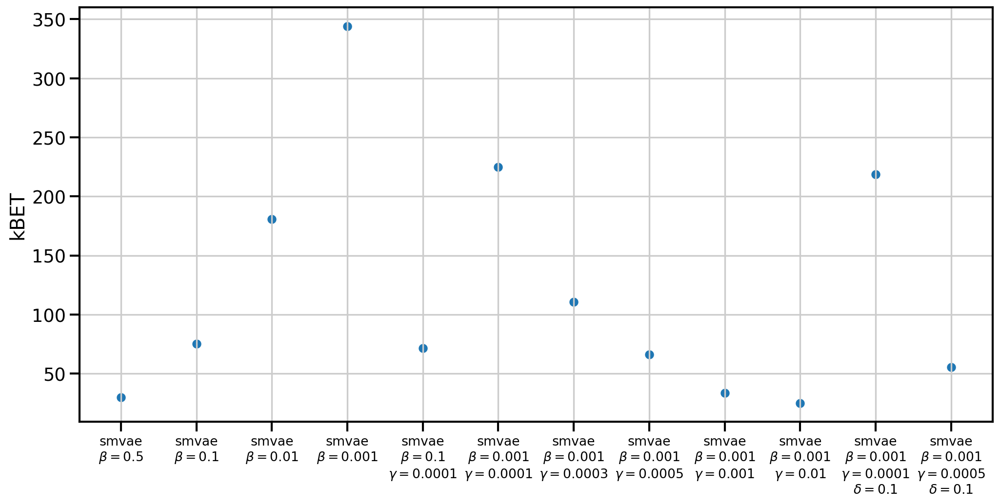

In [275]:
labels = [
    label.replace("_", "\n")
    .replace("beta", r"$\beta=$")
    .replace("gamma", r"$\gamma=$")
    .replace("delta", r"$\delta=$")
    for label in a.iloc[:,0].keys()
]

fig = plt.figure(figsize=(15, 7))
ax = fig.add_subplot(1, 1, 1)
sns.scatterplot(a["stat_mean"], ax=ax)
ax.set_xticks(ticks=range(len(labels)), labels=labels, fontsize=12)
ax.set_ylabel("kBET")